# Final Project CS156 - Random Forests
# Part 1
## Problem Statement

Predicting house prices is one of the most common uses of machine learning models. Most models use house characteristics to predict their current sale price. In reality, most investor or home buyers are interested not only in the current price of a house, but how it will change over time. Assuming that a house is prices accurately at the present given its characteristics, the changes in its future price will depend mostly on external factors, such as the macroeconomic conditions and on whether the neighborhood as a whole becomes more attractive or not. Generally, the interest in a particular neighborhood is a major determinant of the real estate prices in that area, in addition to the characteristics of each particular building. <br><br>
I want to enhance existing models that predict real estate prices by including data on the neighborhood of the house. More specifically, I want to predict house prices using census data, which contains information on the demographics of the population and on the state of the buildings and their surroundings. <br><br>
Predicting future house sale prices is important for a variety of reasons. For one, it can help potential buyers make informed decisions about whether or not to purchase a particular property. By having a good idea of what a house is likely to sell for in the future, buyers can avoid overpaying for a property and can also determine whether or not a particular house is a good investment. Additionally, predicting future house sale prices can be useful for homeowners who are considering selling their property, as it can help them determine the best time to put their house on the market and can also give them a good idea of how much they can expect to receive for their home. Finally, predicting future house sale prices is also important for banks and other financial institutions, as it can help them determine how much to lend for a particular property and can also help them assess the overall health of the housing market.


## Solution Specification

### Data

I used two data sources. For characteristics on the neighborhood and demographics I used the [2010 Brazilian Census](https://censo2010.ibge.gov.br/), which contains detailed information at a census tract level. Census tracts are small geographic units containing around 600 people. This dataset contains thousands of variables, but only a subset was used in the analysis. See the Testing and Analysis section for details. <br><br>

The data on house sale prices was downloaded from [Kaggle](https://www.kaggle.com/datasets/guilherme26/house-pricing-in-belo-horizonte) and contains around 6000 properties sales listing prices in the city of Belo Horizonte in 2021. The data was scraped from a Brazilian listings website and contains the house listing price, number of bedrooms, number of garage places, square footage, and location. <br><br>

I will merge the two datasets so that each house observation also contains data about the census tract where it is located.


#### Census Data

The Census Data comes from the 2010 Brazilian Census. I have included the codebook describing all variables in the Additional Materials. In this notebook, I will translate only the variables that I end up using in the model.

For the purpose of this experiment, I will use two datasets from the Census: the Basic Dataset, which contains information on the number of people, houses, and their earnings, and the General Residence Characteristics dataset, which contains detailed information about the residences in the census tracts.

In [30]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
from shapely import wkt


In [31]:
# Census data on houses
census_houses = pd.read_csv(
    "setor_censitario_domicilio_caracteristicas_gerais_2010.csv")
# Data with basic characteristics of the census tracts
census_tracts = pd.read_csv("geobr_setor_censitario_2010.csv", usecols=[
                            "id_setor_censitario", "nome_municipio", "geometria", "nome_vizinhanca"])
# Basic characteristics of the census tracts
basic = pd.read_csv(
    "/Users/feliphlvo/Documents/Minerva/2022 Fall/CS156/Final Assignment/setor_censitario_basico_2010.csv")


Renaming the columns

In [32]:
census_tracts.rename(columns={
    "id_setor_censitario": "census_tract_id",
    "nome_municipio": "city_name",
    "nome_vizinhanca": "neighborhood_name",
    "geometria": "geometry"}, inplace=True)


In [33]:
census_houses.rename(
    {"id_setor_censitario": "census_tract_id", }, axis=1, inplace=True)


In [34]:
basic.head()


,id_setor_censitario,sigla_uf,v001,v002,v003,v004,v005,v006,v007,v008,v009,v010,v011,v012
0,170025105000002,TO,115.0,300.0,2.61,1.87,648.06,973810.51,866.59,1114445.33,431.20,632388.52,717.70,848395.08
1,170025105000003,TO,59.0,167.0,2.83,2.73,433.73,268023.79,595.12,271797.01,299.05,180862.25,521.32,199666.22
2,170030105000001,TO,286.0,1123.0,3.93,2.76,927.45,35035042.21,1269.15,47569000.34,676.81,23408097.22,1184.76,40408722.36
3,170030105000002,TO,294.0,1101.0,3.74,3.99,478.33,621522.26,645.09,731128.06,442.07,484090.83,717.42,588269.19
4,170030105000003,TO,102.0,385.0,3.77,3.76,453.32,1139597.92,592.81,1411036.13,355.93,514927.18,597.24,721076.91


In [35]:
basic.rename({
    "id_setor_censitario": "census_tract_id"}, axis=1, inplace=True)


Merging two different census datasets

In [36]:
# Merge
census_df = census_houses.merge(
    census_tracts, on="census_tract_id", how="inner")
census_df = census_df.merge(basic, on="census_tract_id", how="inner")
# Filter only for census tracts in Belo Horizonte
census_df = census_df[census_df['city_name'] == 'Belo Horizonte']
# Transform in GeoDataFrame
census_df['geometry'] = census_df['geometry'].apply(wkt.loads)
census_df = gpd.GeoDataFrame(census_df, geometry='geometry')


In [37]:
census_df.head()


,census_tract_id,sigla_uf_x,v001_x,v002_x,v003_x,v004_x,v005_x,v006_x,v007_x,v008_x,...,v003_y,v004_y,v005_y,v006_y,v007_y,v008_y,v009_y,v010_y,v011_y,v012_y
173849,310620005620001,MG,212,212,10.0,0.0,202.0,175.0,3.0,28.0,...,2.41,1.45,6980.83,5.749773e+07,7149.44,5.768193e+07,4002.92,3.615804e+07,5322.56,4.106787e+07
173850,310620005620002,MG,189,189,2.0,0.0,187.0,157.0,3.0,28.0,...,3.11,1.99,11174.20,1.358910e+09,13282.53,1.588749e+09,6570.61,5.233520e+08,9087.01,7.013917e+08
173851,310620005620003,MG,295,295,3.0,3.0,289.0,219.0,10.0,55.0,...,2.79,1.72,8025.51,5.252658e+07,8516.27,5.155562e+07,4785.51,4.106691e+07,6492.77,4.463937e+07
173852,310620005620004,MG,231,226,75.0,0.0,151.0,174.0,18.0,29.0,...,2.84,1.66,5359.17,5.519436e+07,5879.48,5.750511e+07,3013.30,2.839654e+07,4264.10,3.486550e+07
173853,310620005620005,MG,309,295,21.0,0.0,274.0,211.0,11.0,61.0,...,2.72,1.75,7274.49,5.158154e+07,7477.27,5.150288e+07,4353.63,3.563644e+07,5670.88,3.895445e+07


#### House prices 

In [38]:
# from https://www.kaggle.com/datasets/guilherme26/house-pricing-in-belo-horizonte
prices = pd.read_csv(
    "/Users/feliphlvo/Documents/Minerva/2022 Fall/CS156/Final Assignment/data.csv")


In [39]:
prices.head(10)


,address,adm-fees,garage-places,price,rooms,square-foot,neighborhood,city,latitude,longitude
0,"Avenida Raja Gabaglia, 1583",470.0,1,330000.0,1,40,Luxemburgo,Belo Horizonte,-19.936415,-43.953396
1,"Rua Espírito Santo, 1171",NaN,1,480000.0,2,45-65,Centro,Belo Horizonte,-18.864776,-41.121777
2,"Rua dos Expedicionários, 1082",NaN,5,1190000.0,4,411,Santa Amélia,Belo Horizonte,-20.225241,-44.397780
3,"Rua Marechal Hermes, 81",750.0,4,1590000.0,4,158,Gutierrez,Belo Horizonte,-19.937155,-43.958694
4,"Rua Juruna, 110",NaN,6,550000.0,3,278,Pindorama,Belo Horizonte,-19.912982,-44.019944
5,"Rua Maria Pereira de Araújo, 15",500.0,1,450000.0,3,87,Castelo,Belo Horizonte,-19.886147,-44.004236
6,"Rua Espírito Santo, 1580",NaN,2,861748.0,2,60-71,Centro,Belo Horizonte,-18.864776,-41.121777
7,"Rua Matipó, 455",750.0,2,549900.0,4,153,Santo Antônio,Belo Horizonte,-19.947351,-43.943470
8,"Rua Pitangui, 000",NaN,2,890000.0,3,200,Sagrada Família,Belo Horizonte,-19.902339,-43.942072
9,"Avenida dos Bandeirantes, 76",2400.0,3,2550000.0,4,570,Sion,Belo Horizonte,-19.957230,-43.931973


In [40]:
# Turn garage-places, rooms, and square-foot into numeric
prices['garage-places'] = pd.to_numeric(
    prices['garage-places'], errors='coerce')
prices['rooms'] = pd.to_numeric(prices['rooms'], errors='coerce')
prices['square-foot'] = pd.to_numeric(prices['square-foot'], errors='coerce')


In [41]:
prices.head()


,address,adm-fees,garage-places,price,rooms,square-foot,neighborhood,city,latitude,longitude
0,"Avenida Raja Gabaglia, 1583",470.0,1.0,330000.0,1.0,40.0,Luxemburgo,Belo Horizonte,-19.936415,-43.953396
1,"Rua Espírito Santo, 1171",NaN,1.0,480000.0,2.0,NaN,Centro,Belo Horizonte,-18.864776,-41.121777
2,"Rua dos Expedicionários, 1082",NaN,5.0,1190000.0,4.0,411.0,Santa Amélia,Belo Horizonte,-20.225241,-44.397780
3,"Rua Marechal Hermes, 81",750.0,4.0,1590000.0,4.0,158.0,Gutierrez,Belo Horizonte,-19.937155,-43.958694
4,"Rua Juruna, 110",NaN,6.0,550000.0,3.0,278.0,Pindorama,Belo Horizonte,-19.912982,-44.019944


##### Dealing with Outliers

There are some abnormalities in the data, such as houses with over 50 garage spaces. I will remove them, keeping only the observations that have reasonable numbers. I will only keep houses with 5 or less rooms, 3 or less garage places, 100000 square feet, and R$0000000 in price.

Before removing outliers


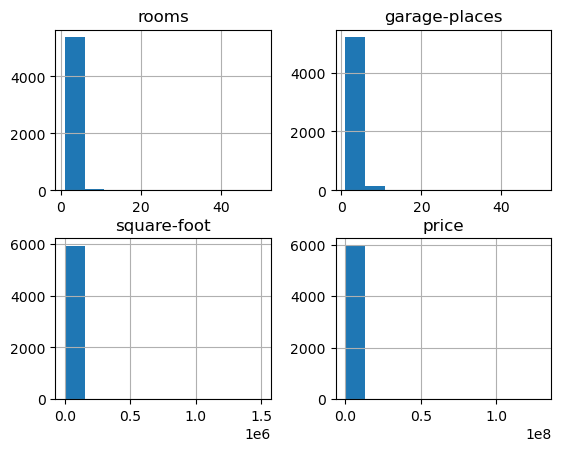

After removing outliers


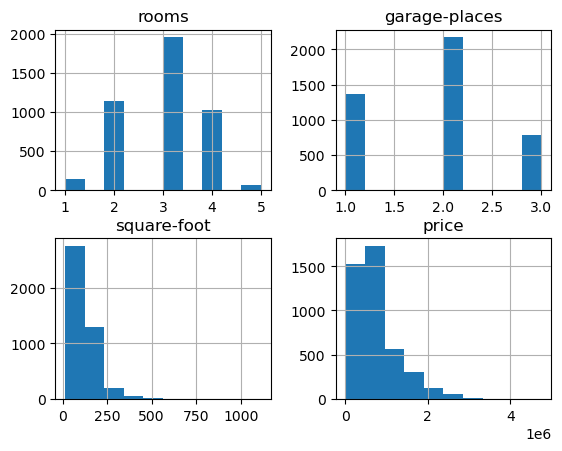

In [42]:
# Checking the distribution of the main variables
print("Before removing outliers")
prices.hist(column=['rooms', 'garage-places', 'square-foot', 'price'])
plt.show()

# Removing outliers
prices = prices[prices['rooms'] < 6]
prices = prices[prices['garage-places'] < 4]
prices = prices[prices['square-foot'] < 100000]
prices = prices[prices['price'] < 10000000]

# Checking the distribution of the main variables
print("After removing outliers")
prices.hist(column=['rooms', 'garage-places', 'square-foot', 'price'])
plt.show()


Since the prices are left-skewed and we want the errors to be based on the percentage of prices, not the abolute number, we apply a log transformation.

In [43]:
# log transformation
prices['price'] = np.log1p(prices['price'])


In [44]:
# convert prices to GeoDataFrame
prices = gpd.GeoDataFrame(prices, geometry=gpd.points_from_xy(
    prices.longitude, prices.latitude))


/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:34: ShapelyDeprecationWarning:

The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.



Creating a combined dataset by adding the census variables to each house price observation based on whether the house is in the census tract

In [45]:
# Merge with census data based on whether lat and long are within the geometry of the census
merged = gpd.sjoin(prices, census_df, how="inner", op='within')


In [46]:
merged.head()


,address,adm-fees,garage-places,price,rooms,square-foot,neighborhood,city,latitude,longitude,...,v003_y,v004_y,v005_y,v006_y,v007_y,v008_y,v009_y,v010_y,v011_y,v012_y
0,"Avenida Raja Gabaglia, 1583",470.0,1.0,12.706851,1.0,40.0,Luxemburgo,Belo Horizonte,-19.936415,-43.953396,...,3.19,1.54,8260.97,56062228.72,9254.1,53604785.69,5248.79,46215659.24,7292.02,49310681.51
534,Rua Cônego Rocha Franco,700.0,2.0,13.567050,3.0,90.0,Gutierrez,Belo Horizonte,-19.935458,-43.954094,...,3.19,1.54,8260.97,56062228.72,9254.1,53604785.69,5248.79,46215659.24,7292.02,49310681.51
1162,Rua Estácio de Sá,800.0,2.0,13.997833,4.0,230.0,Gutierrez,Belo Horizonte,-19.935986,-43.955654,...,3.19,1.54,8260.97,56062228.72,9254.1,53604785.69,5248.79,46215659.24,7292.02,49310681.51
1200,"Rua Estácio de Sá, 400",350.0,2.0,13.353477,4.0,160.0,Gutierrez,Belo Horizonte,-19.935986,-43.955654,...,3.19,1.54,8260.97,56062228.72,9254.1,53604785.69,5248.79,46215659.24,7292.02,49310681.51
2384,"Rua Cônego Rocha Franco, 28",1980.0,3.0,14.235536,4.0,170.0,Gutierrez,Belo Horizonte,-19.935458,-43.954094,...,3.19,1.54,8260.97,56062228.72,9254.1,53604785.69,5248.79,46215659.24,7292.02,49310681.51


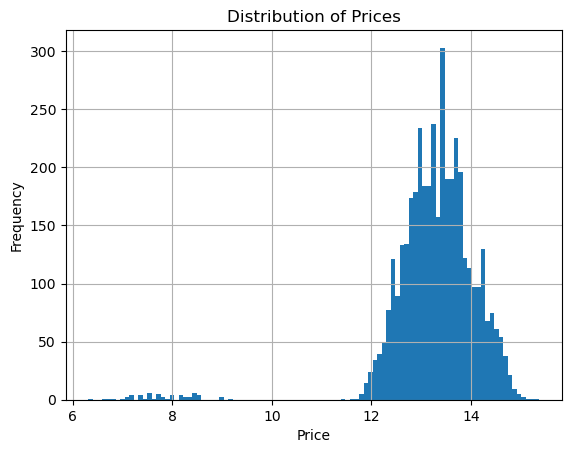

In [47]:
merged["price"].hist(bins=100)
# labels
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.title("Distribution of Prices")

plt.show()


We can see that the data is bimodals, with a cluster of houses with low prices. These houses might be of a different category or simply come from an error in the data. Since the are not representative of the majority of the data, we will remove them.

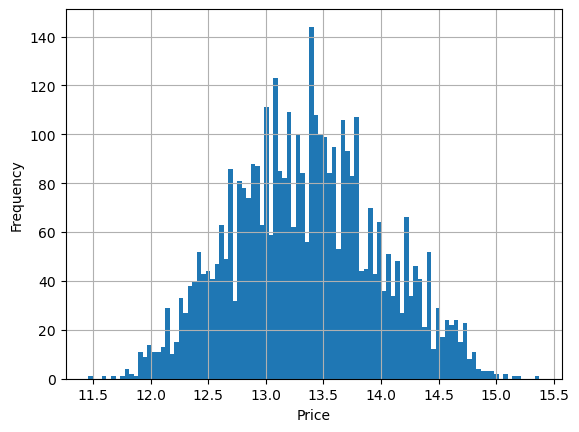

In [48]:
# The cluster of prices below 10 is an anomaly, they should not be that low, so I will remove those observations
merged = merged[merged['price'] > 10]
# Much better!
merged["price"].hist(bins=100)
# labels
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.show()


For the model to work, we need to exclude non-numerical columns and remove observations with missing values.

In [49]:
# Only numerical columns
merged = merged.select_dtypes(exclude=['object'])

# Drop some unnecessary columns and adm-fees (which has too many missing values)
merged = merged.drop(['geometry', 'latitude', 'longitude',
                     'index_right', "adm-fees"], axis=1)

# Drop rows with missing values
merged = merged.dropna()


#### Plotting
Let's plot the average sale price for each census tracts where we have available data. 

In [50]:
# Average price per census tract
import plotly.express as px
census_view = merged.groupby('census_tract_id').mean()['price']
# Merge with census tract data
census_view = census_view.reset_index()
census_merged = census_view.merge(census_df, on='census_tract_id', how='right')
# Turn into geopandas
census_merged = gpd.GeoDataFrame(census_merged, geometry='geometry')
fig = px.choropleth_mapbox(census_merged, geojson=census_merged, locations=census_merged.index, color="price",
                           mapbox_style="open-street-map", opacity=0.5,
                           # Latitude and longitude of Belo Horizonte
                           center={"lat": -19.920, "lon": -43.940},
                           zoom=10,
                           hover_data=["neighborhood_name"],
                           width=1000, height=800,
                           labels={
                               "3sfca_n_teachers": "Accessibility",
                               "3sfca_n_classes": "Accessibility",
                               "neighborhood_name": "Neighborhood",
                               "avg_monthly_earnings": "Average Monthly Earnings",
                               "price": "Average Log Price"},
                           color_continuous_scale="RdYlGn",
                           )

fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0},
                  title="Average Price per Census Tract in Belo Horizonte")


# cut color scale at 10
fig.show()


Figure does now show in HTML. See notebook or zipped file for figure.

## Model

## Random Forest Regressor

I will use a random forest regressor model. <br> <br> 
 It is an ensemble learning method, which means that it combines the predictions of multiple individual models in order to make a more accurate prediction. In the case of a random forest regressor, the individual models are decision trees, which are a common type of predictive model that use a tree-like structure to make decisions. This can be particularly useful when predicting house prices, as there are many different factors that can affect a property's value, such as its location, size, age, and condition. By using multiple individual models, a random forest can better capture the complex relationships between these factors and can make more accurate predictions as a result. <br> <br>
The basic idea behind a random forest regressor is to train a large number of decision trees on a dataset, each of which is trained on a different subset of the data. This is known as bootstrapping, and it helps to reduce overfitting, which is a common problem in machine learning where a model performs well on the training data but poorly on unseen data. By training each decision tree on a different subset of the data, the random forest is able to capture a wider variety of patterns in the data and can make more accurate predictions as a result. <br> <br>


A step by step explanation of how a random forest regressor works is as follows: <br>

One decision tree:
1. The algorithm will construct a tree-like structure, with each internal node representing a decision based on the value of a single input feature, and each leaf node representing a predicted continuous value.

2. The algorithm will split the training data into smaller and smaller subsets based on the values of the input features, creating branches in the tree.Our approach is to use "mean squared error" (MSE) to evaluate the quality of a split. MSE measures the average squared difference between the predicted values and the actual values for the training data that falls within each branch of the tree. The split that results in the lowest MSE is selected. The splitting process continues until the algorithm reaches a pre-defined stopping criteria, such as a maximum tree depth or a minimum number of data points in a leaf node.

3. When making a prediction for a new input, the decision tree will pass the input through the tree, following the branches and making decisions based on the values of the input features. The final prediction will be the continuous value that is associated with the leaf node that the input reaches.

4. The decision tree can then be used to make predictions on new, unseen data by passing the input through the tree and returning the continuous value associated with the leaf node that the input reaches.

Random forest:

1. The algorithm will train multiple decision trees on random subsets of the training data. Each decision tree will be trained to make predictions on the continuous values of price for a given input.

2. When making a prediction for a new input, the random forest regressor will pass the input through each of the trained decision trees and collect their predictions.

3. The final prediction for the input will be calculated by averaging the predictions of all the decision trees. This is known as "ensemble learning", where the individual predictions of the weak models are combined to create a single, stronger prediction.

4. The random forest regressor can then be used to make predictions on new, unseen data by passing the input through the ensemble of decision trees and averaging their predictions.





In [51]:
# Predict price based on census data using a random forest regressor and cross-validation
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score


# Split data into features and target
X = merged.drop(['price'], axis=1)
y = merged['price']

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)


### Feature Selection


The dataset has hundreds of variables, we want to only select features that have a meaningful contribution to the model. I will use the SelectFromModel function to select the features that have the most importance. It works by training a model and then selecting the features that have the highest importance and then only using these features in subsequent models.

In [52]:
# Getting the most important variables to run further parameter selection
sel = SelectFromModel(RandomForestRegressor(n_estimators=100))
sel.fit(X_train, y_train)
sel.get_support()
selected_feat = X_train.columns[(sel.get_support())]


In [53]:
selected_feat


Index(['garage-places', 'rooms', 'square-foot', 'v007_x', 'v025', 'v052',
       'v063', 'v064', 'v119', 'v179', 'v003_y', 'v004_y', 'v005_y', 'v007_y',
       'v009_y', 'v010_y', 'v011_y', 'v012_y'],
      dtype='object')

In [74]:
# Renaming the selected variables based on what they represent
merged_select = merged[selected_feat]
merged_select.rename({
    'v007_x': "monthly_earnings",
    'v025': 'apartments_with_one_bathroom',
    'v063': 'houses_with_at_least_two_residents',
    'v064': 'houses_with_at_least_three_residents',
    'v119': 'houses_with_one_bathroom',
    'v179': 'houses_being_bought',
    'v003_y': "houses",
    'v004_y': "condominiums",
    'v005_y': "apartments",
    'v007_y': 'houses_being_bought_2',
    'v009_y': 'houses_given_by_employer',
    'v010_y': 'houses_acquired_in_other_ways',
    'v011_y': 'houses_with_different_living_situation',
    'v012_y': 'houses_with_access_to_sewage'
}, axis=1, inplace=True)
merged_select['price'] = merged['price']


/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:4441: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-74-dbbff85453a8>:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [75]:
merged_select.head()


,garage-places,rooms,square-foot,monthly_earnings,apartments_with_one_bathroom,v052,houses_with_at_least_two_residents,houses_with_at_least_three_residents,houses_with_one_bathroom,houses_being_bought,houses,condominiums,apartments,houses_being_bought_2,houses_given_by_employer,houses_acquired_in_other_ways,houses_with_different_living_situation,houses_with_access_to_sewage,price
0,1.0,1.0,40.0,14.0,3.0,104.0,54.0,76.0,2.0,14.0,3.19,1.54,8260.97,9254.1,5248.79,46215659.24,7292.02,49310681.51,12.706851
534,2.0,3.0,90.0,14.0,3.0,104.0,54.0,76.0,2.0,14.0,3.19,1.54,8260.97,9254.1,5248.79,46215659.24,7292.02,49310681.51,13.567050
1162,2.0,4.0,230.0,14.0,3.0,104.0,54.0,76.0,2.0,14.0,3.19,1.54,8260.97,9254.1,5248.79,46215659.24,7292.02,49310681.51,13.997833
1200,2.0,4.0,160.0,14.0,3.0,104.0,54.0,76.0,2.0,14.0,3.19,1.54,8260.97,9254.1,5248.79,46215659.24,7292.02,49310681.51,13.353477
2384,3.0,4.0,170.0,14.0,3.0,104.0,54.0,76.0,2.0,14.0,3.19,1.54,8260.97,9254.1,5248.79,46215659.24,7292.02,49310681.51,14.235536


In [77]:
X = merged_select.drop(['price'], axis=1)
y = merged_select['price']
X_train_select, X_test_select, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)


### Hyperparameter Tuning

#### Implementing a Random Grid Search

Now, we want to tune the hyperparameters of the model. Testing all combinations of hyperparameters is computationally expensive, so we will use a random grid search to find a good set of hyperparameters. We will use the RandomizedSearchCV function to do this, which will randomly select a set of hyperparameters and then test them, returning the best combination it found. We will use 5-fold cross validation to test the model.

In [57]:
def evaluate(model, test_features, test_labels):
    """
    Function to evaluate the performance of the model
    """
    predictions = np.expm1(model.predict(test_features))
    # Absolute errors
    errors = abs(predictions - np.expm1(test_labels))
    # Calculate mean absolute percentage error (MAPE)
    mape = 100 * np.mean(errors / np.expm1(test_labels))
    accuracy = 100 - mape
    print('Model Performance')
    print('Average Error: {:0.4f} reais.'.format(np.mean(errors)))
    print('Accuracy = {:0.2f}%.'.format(accuracy))

    return accuracy


We start with a base model as a benchmark.

In [58]:

base_model = RandomForestRegressor(n_estimators=10, random_state=42)
base_model.fit(X_train_select, y_train)
base_accuracy = evaluate(base_model, X_test_select, y_test)


Model Performance
Average Error: 141416.1503 reais.
Accuracy = 80.66%.


Here we specify the parameters we want to test in our Randomized Search. We won't change all hyperparameters, only the ones that are generally considered the most important: the number of trees in the forest, the number of features to consider at every split, the maximum number of levels in each tree, the minimum number of samples required to split a node, the minimum number of samples required at each leaf node, and the method for selecting samples for training each tree.

In [59]:
# Instantiate model with 1000 decision trees
from sklearn.model_selection import RandomizedSearchCV


# Number of trees in random forest
n_estimators = [100, 200, 500, 1000, 2000]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [10, 20, 50, 100, None]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

random_grid


{'n_estimators': [100, 200, 500, 1000, 2000],
 'max_features': ['auto', 'sqrt'],
 'max_depth': [10, 20, 50, 100, None],
 'min_samples_split': [2, 5, 10],
 'min_samples_leaf': [1, 2, 4],
 'bootstrap': [True, False]}

In [60]:
from sklearn.model_selection import RandomizedSearchCV
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestRegressor()
# Random search of parameters, using 3 fold cross validation,
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=random_grid,
                               n_iter=20, cv=5, verbose=2, random_state=42, n_jobs=-1)
# Fit the random search model
rf_random.fit(X_train_select, y_train)


Fitting 5 folds for each of 20 candidates, totalling 100 fits


/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=20,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 50, 100, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 500, 1000,
                                                         2000]},
                   random_state=42, verbose=2)

Let's evaluate the best model found by the random search. 

In [61]:

best_random = rf_random.best_estimator_
random_accuracy = evaluate(best_random, X_test_select, y_test)

print('Improvement of {:0.2f}%.'.format(
    100 * (random_accuracy - base_accuracy) / base_accuracy))


Model Performance
Average Error: 131104.5710 reais.
Accuracy = 82.36%.
Improvement of 2.11%.


These are the parameters with the best performance:

In [62]:
rf_random.best_params_


{'n_estimators': 2000,
 'min_samples_split': 2,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 20,
 'bootstrap': True}

#### Grid Search

Now, I will take the best parameters from the random grid search and use themas a basis for a more fine-tuned extensive grid search., which will actually test all combinations around the best parameters found in the previous step. 

In [63]:
# Grid Search based on previous results

from sklearn.model_selection import GridSearchCV
# Create the parameter grid based on the results of random search
param_grid = {
    'bootstrap': [True],
    'max_depth': [10, 20, 30],
    'max_features': ['sqrt'],
    'min_samples_leaf': [1, 2],
    'min_samples_split': [1, 2, 4],
    'n_estimators': [2000]
}
# Create a based model
rf = RandomForestRegressor()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid,
                           cv=5, n_jobs=-1, verbose=2)
# Fit the grid search to the data
grid_search.fit(X_train_select, y_train)


Fitting 5 folds for each of 18 candidates, totalling 90 fits


/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning:


30 fits failed out of a total of 90.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/feliphlvo/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/feliphlvo/

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'bootstrap': [True], 'max_depth': [10, 20, 30],
                         'max_features': ['sqrt'], 'min_samples_leaf': [1, 2],
                         'min_samples_split': [1, 2, 4],
                         'n_estimators': [2000]},
             verbose=2)

In [64]:
grid_search.best_params_


{'bootstrap': True,
 'max_depth': 20,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 2000}

In [65]:
best_grid = grid_search.best_estimator_
grid_accuracy = evaluate(best_grid, X_test_select, y_test)

print('Improvement over best random model of {:0.2f}%.'.format(
    100 * (grid_accuracy - random_accuracy) / random_accuracy))


Model Performance
Average Error: 130888.7242 reais.
Accuracy = 82.39%.
Improvement over best random model of 0.03%.


We see that the best model is the one that was found using the grid search, but it has a mere 0.12% improvement over our best random model.

### Analyzig Results of our best model

#### Metric

My metric of choice for analyzing this model is the mean average percentage error (MAPE). It is a common metric for evaluating the accuracy of a model in the real estate industry because in investments we care more about percentage in returns than absolute numbers. It is calculated by taking the absolute value of the difference between the predicted and actual values and dividing it by the actual value. The lower the MAPE, the better the model. 

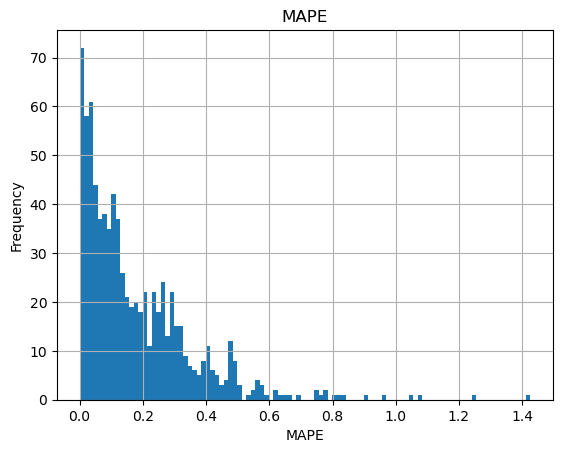

In [66]:
# Compare predicted results with actual values
y_pred_norm = np.expm1(best_grid.predict(X_test_select))
y_test_norm = np.expm1(y_test)
df = pd.DataFrame({'Actual': y_test_norm, 'Predicted': y_pred_norm, 'Difference': y_pred_norm - y_test_norm,
                  "MPE": (y_test_norm - y_pred_norm)/y_test_norm, "MAPE": abs(y_test_norm - y_pred_norm)/y_test_norm}).reset_index()

# histogram of MAPE
df['MAPE'].hist(bins=100)
plt.title("MAPE")
plt.xlabel("MAPE")
plt.ylabel("Frequency")
plt.show()


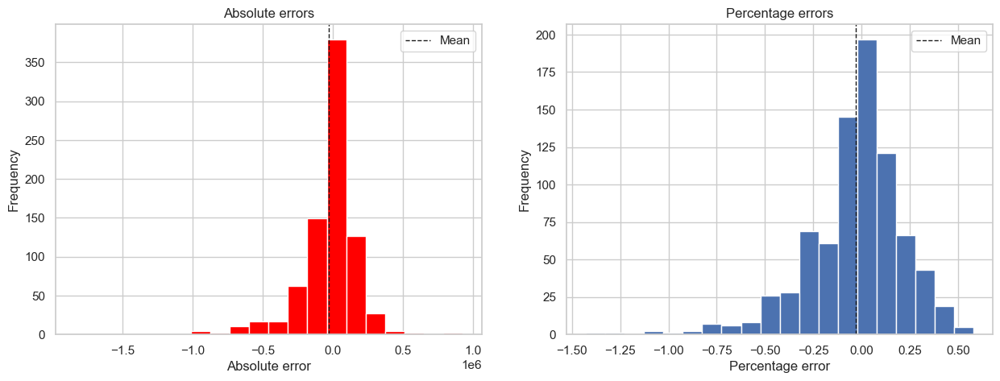

In [67]:
import seaborn as sns
sns.set(style="whitegrid")


def plot_errors(df):
    # Two subplots, one for absolute errors and one for percentage errors
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    # Plot distribution of absolute errors
    ax1.hist(df['Difference'], bins=20, color='red')
    ax1.set_title("Absolute errors")
    ax1.set_xlabel("Absolute error")
    ax1.set_ylabel("Frequency")
    # Plot distribution of percentage errors
    ax2.hist(df['MPE'], bins=20)
    ax2.set_title("Percentage errors")
    ax2.set_xlabel("Percentage error")
    ax2.set_ylabel("Frequency")

    # Show mean as a vertical line
    ax1.axvline(df['Difference'].mean(), color='k',
                linestyle='dashed', linewidth=1, label='Mean')
    ax2.axvline(df['MPE'].mean(), color='k',
                linestyle='dashed', linewidth=1, label='Mean')

    # Show label
    ax1.legend()
    ax2.legend()
    plt.show()


plot_errors(df)


In [68]:
print("Mean Absolute Percentage Error (MAPE):", df['MAPE'].mean())
print("Accuracy: {:0.2f}%".format(100 - df['MAPE'].mean()*100))


Mean Absolute Percentage Error (MAPE): 0.17614713612195262
Accuracy: 82.39%


We achieve an impressive accuracy of 82.5%. This means that on average, the model misses the actual price by 17.5%. The errors seem to be left skewed. The model tends to make more overpricing than underpricing, but the underpricing is more extreme. Overall, though, we don't see any huge errors, which is important in investments.

To ensure our solution is the best available, We can compare our results with the one of the most succesful tree models, XGBoost.

### Feature importance

We can analyze the importance of each of our features to see if the census data contributed significantly to our model. <br><br>

It seems like the most important variables are still characteristic about the house itself, but the number of houses that are not bought, rented, or given and the number of houses currently being purchasesd are also important features. They could indicate that the housing market is "active" in that region, although it's impossible to say if those variables contribute positively or negatively to the model, given the nature of random forests.

In [69]:
# Show feature importance
importances = pd.DataFrame({'feature': X_train_select.columns,
                           'importance': np.round(best_grid.feature_importances_, 3)})
importances = importances.sort_values(
    'importance', ascending=False).set_index('feature')
importances.head(15)


,importance
feature,
square-foot,0.214
garage-places,0.194
rooms,0.102
houses_with_different_living_situation,0.066
houses_being_bought,0.063
houses_acquired_in_other_ways,0.051
houses_given_by_employer,0.040
apartments,0.038
houses_with_access_to_sewage,0.036


## XGBoost

XGBoost is considered the state-of-the-art model for regression problems. It is a gradient boosting model, which means it builds a model by adding weak learners to a model. 

Both random forest regression and XGBoost are powerful machine learning algorithms that can be used for regression tasks. One advantage of random forest regression over XGBoost is that it is easier to train and tune. This is because random forest regression models are made up of many individual decision trees, and each tree can be trained and tuned independently. In contrast, XGBoost involves training a large number of trees simultaneously, which can make it more challenging to optimize.

Another advantage of random forest regression is that it is less sensitive to overfitting. Because random forest models are made up of many individual trees that are trained on different subsets of the data, they are less likely to overfit to the training data than a single large tree, such as those used in XGBoost.

One potential disadvantage of random forest regression is that it can be less accurate than XGBoost. This is because XGBoost uses a more sophisticated training algorithm that can better optimize the model to make accurate predictions. However, this disadvantage may be mitigated if the random forest model is properly tuned and trained on a large enough dataset.


I will make a simple version of it using the default parameters to compare with our accuracy in the best random-forest model we found.

In [70]:
import xgboost as xgb


,garage-places,rooms,square-foot,monthly_earnings,apartments_with_one_bathroom,v052,houses_with_at_least_two_residents,houses_with_at_least_three_residents,houses_with_one_bathroom,houses_being_bought,houses,condominiums,apartments,houses_being_bought,houses_given_by_employer,houses_acquired_in_other_ways,houses_with_different_living_situation,houses_with_access_to_sewage
5885,2.0,3.0,91.0,6.0,13.0,54.0,32.0,17.0,0.0,6.0,2.67,1.81,4873.38,5237.06,2935.52,40003860.38,3945.05,49802523.70
555,2.0,3.0,76.0,50.0,58.0,37.0,22.0,20.0,0.0,46.0,2.96,1.29,2453.18,2519.48,1612.40,3568773.19,2093.94,3626523.49
4409,1.0,3.0,14.0,4.0,28.0,10.0,7.0,7.0,27.0,2.0,3.14,2.41,885.79,1120.26,631.89,492078.59,947.84,437937.28
1609,2.0,2.0,110.0,9.0,26.0,67.0,40.0,31.0,2.0,8.0,2.81,1.57,5546.96,5871.89,3187.61,16428078.90,4241.63,17391372.02
3471,2.0,2.0,60.0,114.0,187.0,71.0,51.0,28.0,8.0,113.0,2.55,1.31,3076.24,3137.52,1978.28,4039352.39,2501.02,3798777.35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,2.0,3.0,85.0,16.0,102.0,52.0,32.0,39.0,83.0,15.0,2.94,1.87,2426.95,2640.78,1358.06,3996217.60,2009.31,4605409.08
5093,2.0,4.0,164.0,0.0,0.0,5.0,3.0,2.0,0.0,0.0,2.35,1.29,7055.00,7055.00,4229.29,19469816.55,5730.00,17723020.00
4042,2.0,2.0,85.0,12.0,5.0,36.0,13.0,24.0,0.0,12.0,2.63,1.53,6287.09,6790.06,4185.55,25899493.77,5788.53,26541520.32
2364,2.0,3.0,104.0,4.0,45.0,21.0,15.0,12.0,4.0,4.0,2.13,1.21,5711.40,6038.81,4156.21,21677808.22,5254.97,21634565.61


In [78]:
bst = xgb.XGBRegressor(random_state=42)
# fit model
bst.fit(X_train_select, y_train)
# make predictions
xg_preds = bst.predict(X_test_select)


In [79]:
# evaluate predictions
evaluate(bst, X_test_select, y_test)


Model Performance
Average Error: 134337.7456 reais.
Accuracy = 81.62%.


81.61940939925239

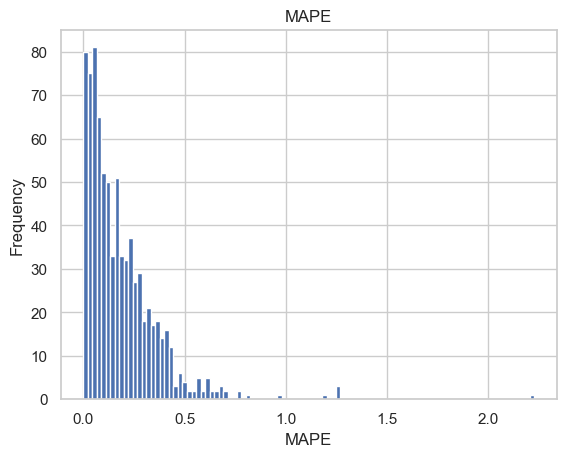

In [80]:
# Compare predicted results with actual values
y_pred_norm = np.expm1(bst.predict(X_test_select))
y_test_norm = np.expm1(y_test)
xg_df = pd.DataFrame({'Actual': y_test_norm, 'Predicted': y_pred_norm, 'Difference': y_pred_norm - y_test_norm,
                     "MPE": (y_test_norm - y_pred_norm)/y_test_norm, "MAPE": abs(y_test_norm - y_pred_norm)/y_test_norm}).reset_index()

# histogram of MAPE
xg_df['MAPE'].hist(bins=100)
plt.title("MAPE")
plt.xlabel("MAPE")
plt.ylabel("Frequency")
plt.show()


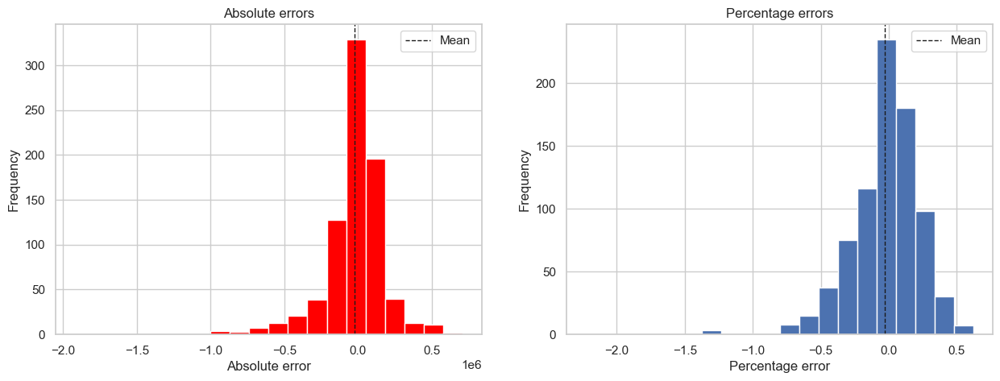

In [81]:
plot_errors(xg_df)


Without any hyperparameter tuning we achieve an impressive 80% accuracy, but it still lower than the 82% from our best random tree. With a bit of tuning, we might be able to improve this result, but for now, we can have some confidence that our chosen model is the best available.

## References
Risle. (2021, November 4). House pricing in Belo Horizonte. Kaggle. Retrieved December 15, 2022, from https://www.kaggle.com/datasets/guilherme26/house-pricing-in-belo-horizonte 

IBGE. (2010). IBGE | Censo 2010. Retrieved December 15, 2022, from https://censo2010.ibge.gov.br/

sklearn. (2022). Scikit-learn: Machine learning in Python—Scikit-learn 1.2.0 documentation. Retrieved December 15, 2022, from https://scikit-learn.org/stable/index.html



# Part 2: Lesson Plan
# Background Readings
Deng, H. (2021, April 26). An introduction to random forest. Medium. Retrieved December 15, 2022, from https://towardsdatascience.com/random-forest-3a55c3aca46d <br>
**Why/Read**: Great explanation of random forests in general, with an intuitive description of feature importance.

Wikimedia Foundation. (2022, November 29). Random Forest. Wikipedia. Retrieved December 15, 2022, from https://en.wikipedia.org/wiki/Random_forest 
<br>**Why/Read**: As always, Wikipedia is a good overview of the topic. The page ranges from intuitive explanations of how random forests work to detailed descriptions of the math behind the model and some of its applications. 

Koehrsen, W. (2018, January 17). Random Forest in python. Medium. Retrieved December 15, 2022, from https://towardsdatascience.com/random-forest-in-python-24d0893d51c0
<br>**Why/Read**:  An application of random forests models in Python using sklearn. 

Sklearn. (n.d.). Sklearn.ensemble.randomforestregressor. scikit. Retrieved December 15, 2022, from https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html
<br>**Why/Read**: Documentation for the function implementing random forests in sklearn. This is where you will find a description of all parameters, as well as example notebooks on how to implement it.


Thorn, J. (2021, September 26). Random Forest: Hyperparameters and how to fine-tune them. Medium. Retrieved December 15, 2022, from https://towardsdatascience.com/random-forest-hyperparameters-and-how-to-fine-tune-them-17aee785ee0d
<br>**Why/Read**: A more detailed description of hyperparameters and an overview of how to build a pipeline to fine-tune them. 

# Pre-class Work: Random Forest Regressors
In this notebook, we will explore some challenge questions about random forests. We will use the scikit-learn library to train and evaluate random forest models, and we will use matplotlib to visualize the results.

First, let's import the necessary libraries:

In [82]:
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt


## Challenge Question 1

In your own words, explain how a Random Forest Regression model works.

## Question 2
Suppose we train a random forest regressor on a synthetic regression dataset. We use the default settings for the RandomForestRegressor in scikit-learn, which includes 100 trees and uses the mean squared error criterion for splitting.

In [ ]:
# Generate a synthetic regression dataset
X, y = make_regression(n_samples=1000, n_features=10,
                       n_informative=5, random_state=42)

# Split the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

# Train a random forest regressor with 100 trees and the default mean squared error criterion
regr = RandomForestRegressor(
    n_estimators=  # FILL IN
    random_state=42)
regr.fit(X_train, y_train)

# Evaluate the model on the test set
mse = np.mean((regr.predict(X_test) - y_test) ** 2)
print("Mean squared error: {:.2f}".format(mse))


## Question 3
Let's train another model. This time we use the mean absolute error criterion for splitting.

What is the mean absolute error of the model on the test set, and how does it compare to the error in the previous model?

In [ ]:
# Train a random forest regressor with 100 trees and the mean absolute error criterion
regr = RandomForestRegressor(
    n_estimators=# Fill in
    criterion=# Fill in
    random_state=42)
regr.fit(X_train, y_train)

# Evaluate the model on the test set
mae = np.mean(np.abs(regr.predict(X_test) - y_test))

print("Mean absolute error: {:.2f}".format(mae))


Mean absolute error: 9.65


## Question 4
Suppose we train a random forest regressor on the same dataset as in Challenge Questions 2 and 3, but this time we increase the number of trees to 1000.

In [ ]:
# Train a random forest regressor with 1000 trees and the mean squared error criterion
regr = RandomForestRegressor(
    n_estimators=# Fill in,
    random_state=42)
regr.fit(X_train, y_train)

# Evaluate the model on the test set
mse = np.mean((regr.predict(X_test) - y_test) ** 2)
print("Mean squared error: {:.2f}".format(mse))


Mean squared error: 170.71


## Question 5

Checkout the sklearn documentation for the other hyperparameters of the Random Forest model and try to change some of them to see how they affect the model performance. For extra points, make a pipeline to select hyperparameters automatically!

In [ ]:
# Fill in


# Class Activity

#### Motivation
 In the activity, I want students to understand how a collection of individual learners can be stronger than one strong learner. They will see in practice how the power of the crowd can generate more accurate predictions than any individual and how this concept is applied in random forest models.

### The Activity:
#### Breakout:
Split the class into groups of two. Each group will be given a random subset of a dataset (as an example, I will use the diabetes dataset from sklearn). Each group will then train a single regression tree on this subset of the data and report their predictions for a set of 10 unobserved variables. See the breakout notebook below.
#### Main Class
When the students get back, there will be a spreadsheet where they can paste the predicted values. The spreadsheet will calculate the errors for each of the individual predictions. It will also get the average of each prediction and use that as a new prediction, just like random forest models do. It will report the errors for these new predictions. 
Students will be able to see that their individual predictions were bad, but when combined they became more accurate, even though individually no tree was really accurate. 
See the working example spreadsheet here.

#### Discussion Starters:
Why are the averaged predictions more accurate?
How does this activity relate to what random forest models do?
Under what conditions could this not work?


## Breakout Notebook

Train a simple regression tree on the subset of the data you have. Record the predictions and be ready to paste them after the breakout ends

In [ ]:
# Train a regression tree on the diabetes
from sklearn.datasets import load_diabetes
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as MSE

# Set seed for reproducibility
SEED = 1

# Load data
diab = load_diabetes(as_frame=True)

# X is a random sample of 100 observations
# y is the corresponding target values
X = diab.data[:100]
y = diab.target[:100]

# The test set contains 10 observations
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=10, random_state=SEED)

# Instantiate a DecisionTreeRegressor dt, with a max_depth of 3
# THIS LINE WOULD BE DONE BY STUDENTS
dt = DecisionTreeRegressor(max_depth=3, random_state=SEED)

# Fit dt to the training set
dt.fit(X_train, y_train)

# Predict test set labels
y_pred = dt.predict(X_test)


In [ ]:
y_pred


array([141.32142857,  83.25      , 108.625     , 141.32142857,
       108.625     , 141.32142857, 141.32142857,  83.25      ,
        83.25      , 141.32142857])